In [43]:
# '''
# function ConnectButton(){
#     console.log("Connect pushed"); 
#     document.querySelector("#top-toolbar > colab-connect-button").shadowRoot.querySelector("#connect").click() 
# }

# setInterval(ConnectButton,60000);
# '''

# from google.colab import drive
# from os import chdir

# drive.mount('/content/drive')
# project_path = '/content/drive/MyDrive/Gproject/O_GlcNAc_Final_Features'
# chdir(project_path)

# header

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
import random
import os
from os.path import exists

from src.utils import *

update = False

# load database

In [45]:
import os
import pandas as pd

DATA_PATH = './data'
PROTEIN_LIST_PATH = os.path.join(DATA_PATH, 'protein_list')

# Get the list of protein files without '.pkl' extension
protein_list = [x.split('.')[0] for x in os.listdir(PROTEIN_LIST_PATH) if x.endswith('.pkl')]
protein_list.remove('Q62523')

# Load and concatenate data from each pickle file
raw_data_files = [pd.read_pickle(os.path.join(DATA_PATH, 'augmented_features', f'{protein}.pkl')) for protein in protein_list]
RAW_DATA = pd.concat(raw_data_files, axis=0)

print(RAW_DATA)

     protein     # SEQ  positivity  flexibility SS    ASA    Phi    Psi  \
0     P0CG49     1   M           0        0.590  E   23.1 -131.2  146.3   
1     P0CG49     2   Q           0        0.607  E   65.2 -102.1  128.4   
2     P0CG49     3   I           0        0.655  E    6.3 -114.2  129.8   
3     P0CG49     4   F           0        0.706  E   47.0 -110.3  129.7   
4     P0CG49     5   V           0        0.744  E    4.3 -120.4  134.1   
...      ...   ...  ..         ...          ... ..    ...    ...    ...   
1259  Q8BMB0  1260   A           0        0.471  C   77.0  -82.6   -2.3   
1260  Q8BMB0  1261   V           0        0.463  C  102.0  -86.2   39.0   
1261  Q8BMB0  1262   E           0        0.415  C  139.9  -87.7   76.6   
1262  Q8BMB0  1263   R           0        0.372  C  178.9  -92.9  121.5   
1263  Q8BMB0  1264   S           0        0.342  C   96.6  -97.9  129.7   

      Theta(i-1=>i+1)  ...  scm-pos-all-10A  scm-pos-all-15A  scm-pos-all-20A  \
0               13

In [46]:
MAULI_FEATURE = pd.read_csv(f'{DATA_PATH}/feature_names/Mauli_feature.csv')
NEW_FEATURE = pd.read_csv(f'{DATA_PATH}/feature_names/new_feature.csv')
SAP_FEATURE = pd.read_csv(f'{DATA_PATH}/feature_names/SAP_feature.csv')

display(MAULI_FEATURE)
display(NEW_FEATURE)
display(SAP_FEATURE)

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,19,20,21,22,23,24,25,26,27,28
0,0,protein,#,SEQ,positivity,flexibility,SS,ASA,Phi,Psi,...,side_1,side_2,side_3,side_4,side_5,"nAli(-3, -1)","nPos(-7, -5)",nS/nT,is_proline(1),phi_psi


,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,494,495,496,497,498,499,500,501,502,503
0,0,resid,number_hydrophobic_0A,number_hydrophilic_0A,number_polar_0A,number_aromatic_0A,number_aliphatic_0A,number_charged_0A,number_positive_0A,number_negative_0A,...,sasa_tyr_25A,sasa_back_25A,sasa_side_25A,sasa_target_ser_thr_25A,net_charge_all_25A,net_charge_backbone_25A,net_charge_sidechain_25A,net_charge_all_exposed_25A,net_charge_backbone_exposed_25A,net_charge_sidechain_exposed_25A


,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,27,28,29,30,31,32,33,34,35,36
0,0,resid,5A-sap-pos-only-0A,5A-sap-pos-only-5A,5A-sap-pos-only-10A,5A-sap-pos-only-15A,5A-sap-pos-only-20A,5A-sap-pos-only-25A,10A-sap-pos-only-0A,10A-sap-pos-only-5A,...,scm-pos-all-10A,scm-pos-all-15A,scm-pos-all-20A,scm-pos-all-25A,scm-neg-all-0A,scm-neg-all-5A,scm-neg-all-10A,scm-neg-all-15A,scm-neg-all-20A,scm-neg-all-25A


In [47]:
TARGET_AA = RAW_DATA[(RAW_DATA['SEQ']=='S')|(RAW_DATA['SEQ']=='T')].reset_index(drop=True)

print('total number of proteins:', len(TARGET_AA.protein.unique()))
print('double-check # of proteins:', len(protein_list))
num_sample = len(TARGET_AA)
num_pos = TARGET_AA.positivity.sum()
print(f'positivity: {num_pos}, negative: {num_sample - num_pos}')

display(TARGET_AA)

total number of proteins: 105
double-check # of proteins: 105
positivity: 424, negative: 10932


,protein,#,SEQ,positivity,flexibility,SS,ASA,Phi,Psi,Theta(i-1=>i+1),...,scm-pos-all-10A,scm-pos-all-15A,scm-pos-all-20A,scm-pos-all-25A,scm-neg-all-0A,scm-neg-all-5A,scm-neg-all-10A,scm-neg-all-15A,scm-neg-all-20A,scm-neg-all-25A
0,P0CG49,7,T,0,0.734,C,13.2,-97.1,167.8,126.8,...,1697.659999,2470.760001,2815.340000,3590.199998,0.00,99.240001,470.580001,2641.780004,5644.140004,9524.160003
1,P0CG49,9,T,0,0.713,C,88.5,-92.3,-3.9,95.9,...,1266.899998,2113.599999,2882.520000,4231.439999,1.88,4.800000,112.320001,1558.440002,5499.200005,10039.240002
2,P0CG49,12,T,0,0.772,E,59.2,-101.8,133.5,119.7,...,1250.279998,2035.520001,2423.620000,2809.719999,0.00,75.140000,451.200000,2072.040003,4357.480007,7229.720002
3,P0CG49,14,T,0,0.806,E,57.5,-99.9,128.3,116.7,...,944.399999,1977.440001,2309.260001,2699.000000,21.16,270.819999,1060.180001,2992.640002,4287.580007,6114.640009
4,P0CG49,20,S,0,0.775,C,81.6,-87.4,0.5,94.2,...,92.000000,574.560001,1834.020001,2276.620001,44.76,927.519999,2169.600002,3158.580003,3885.380005,4343.860006
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11351,Q8BMB0,1252,T,0,0.516,C,84.0,-88.5,128.5,112.2,...,0.480000,27.600000,78.320001,155.520002,51.28,346.320000,627.439999,729.439998,802.839997,1640.799993
11352,Q8BMB0,1255,S,0,0.490,C,49.5,-80.4,143.6,115.0,...,44.360001,48.040001,82.000001,106.600001,11.14,131.400000,233.960001,411.560001,1141.799997,1844.839998
11353,Q8BMB0,1257,S,0,0.474,C,81.3,-71.6,-26.3,96.1,...,48.040001,48.760001,50.760001,121.380001,0.68,30.960000,103.680001,293.840001,341.880001,1411.879999
11354,Q8BMB0,1259,S,0,0.468,C,79.1,-79.2,-12.8,98.3,...,48.280001,67.700001,67.700001,408.800004,0.54,56.960000,67.480000,142.620000,276.600001,1000.960001


# common functions

## neural networks

In [48]:
from src.data_preparation import custom_dummies, data_to_sequence
from src.custom_loss import weighted_categorical_crossentropy
from src.custom_regularizer import SGL21
from src.custom_models import LSTM_cls, LSTM_cls_v2

class LSTM_CLS():
    
    def __init__(self, parameters, x_shape, y_shape, seed=0):
        self.x_shape  = x_shape
        self.y_shape  = y_shape
        
        self.parameters = parameters

        if len(x_shape) == 2:
            x_dim = x_shape[1]
        elif len(x_shape) == 3:
            x_dim = x_shape[2]
            x_window = x_shape[1]
            
        if len(y_shape) == 2:
            y_dim = y_shape[1]
        elif len(y_shape) == 3:
            y_dim = y_shape[2]
            
        rnn_layers    = self.parameters['rnn_layers']
        rnn_neurons   = self.parameters['rnn_neurons']
        dnn_layers    = self.parameters['dnn_layers']
        dnn_neurons   = self.parameters['dnn_neurons']
        learning_rate = self.parameters['learning_rate']
        c_value       = self.parameters['c_value']
        weight_loss   = self.parameters['weight_loss']
            
        tf.random.set_seed(seed)
        self.model = LSTM_cls(
            window_len    = x_window, x_dim=x_dim, y_dim=y_dim, 
            rnn_layers    = rnn_layers, 
            rnn_neurons   = rnn_neurons, 
            dnn_layers    = dnn_layers, 
            dnn_neurons   = dnn_neurons, 
            learning_rate = learning_rate, 
            kernel_regularizer = SGL21(c_value=c_value), 
            loss_func='categorical_crossentropy' if  weight_loss == 1 else weighted_categorical_crossentropy([1, weight_loss]))
        
        self.model_id =  f'LSTM_{x_shape}_{y_shape}'
        self.model_id += f'_RNN_({rnn_layers},{rnn_neurons})'
        self.model_id += f'_DNN_({dnn_layers},{dnn_neurons})'
        self.model_id += f'_LR_{learning_rate}_C_{c_value}_LW_{weight_loss}'

In [49]:
def preprocess_data(protein_list, data_path, window_size, 
                    x_cts, x_cat, y_cts, y_cat, dummies):
    window_range = (-window_size, window_size)
    sequence_x, sequence_y = [], []

    for name in protein_list:
        path_n_name = f'{data_path}/augmented_features/{name}.pkl'
        data = load_data(path_n_name)
        data_x = custom_dummies(data[x_cts+x_cat], x_cts, x_cat, dummies)
        data_y = custom_dummies(data[y_cts+y_cat], y_cts, y_cat, dummies)
        x, y = data_to_sequence(data_x, data_y, window_range)
        sequence_x.append(x)
        sequence_y.append(y)
    
    feature_x = list(data_x.columns)
    class_y   = list(data_y.columns)
    
    return np.concatenate(sequence_x), np.concatenate(sequence_y), feature_x, class_y

## For training

In [50]:
from src.custom_metrics import evaluate_cls

import warnings
warnings.simplefilter('ignore')

from IPython.display import clear_output

from sklearn.model_selection import StratifiedShuffleSplit
import random
import tensorflow as tf
from tensorflow import keras

epochs = 1000
from keras.callbacks import ModelCheckpoint, EarlyStopping
patience = 30
callbacks = [EarlyStopping(patience=patience, restore_best_weights=True, monitor='val_loss')]

import warnings
warnings.simplefilter('ignore')

In [51]:
def data_scaling(train_data, test_data):
    if len(train_data.shape) > 2:
        x_min, x_max = train_data.min(0).min(0), train_data.max(0).max(0)
    else:
        x_min, x_max = train_data.min(0), train_data.max(0)
        
    train_data_sc = (train_data - x_min) / (x_max - x_min)
    test_data_sc  = (test_data - x_min)  / (x_max - x_min)
        
    return train_data_sc, test_data_sc

def upsample_data(TRAIN_X, TRAIN_Y, seed=0):
    np.random.seed(seed)
    pos_indices = np.where(TRAIN_Y[:,1] == 1)[0]
    neg_indices = np.where(TRAIN_Y[:,1] == 0)[0]
    pos_upsampled = np.random.choice(pos_indices, size=len(neg_indices), replace=True)
    TRAIN_X = np.concatenate([TRAIN_X[pos_upsampled], TRAIN_X[neg_indices]], axis=0)
    TRAIN_Y = np.concatenate([TRAIN_Y[pos_upsampled], TRAIN_Y[neg_indices]], axis=0)
    shuffle_indices = np.arange(len(TRAIN_X))
    np.random.shuffle(shuffle_indices)
    return TRAIN_X[shuffle_indices], TRAIN_Y[shuffle_indices]

In [52]:
n_splits = 5
test_size = 0.2
sample_ratio = 1
c_value = 0.00001

SEARCH_SPACE = {
    'learning_rate' : [],
    'window_size' : [10, 15, 20],
    'rnn_layers'  : [3, 4, 5],
    'rnn_neurons' : [64, 128],
    'dnn_layers'  : [2, 3, 4],
    'dnn_neurons' : [],
    'weight_loss' : [],
    'c_value'     : [],
}

initial_parameters = {
    'learning_rate' : 0.001,
    'window_size' : 20,
    'rnn_layers'  : 3,
    'rnn_neurons' : 128,
    'dnn_layers'  : 3,
    'dnn_neurons' : 128,
    'weight_loss' : 1,
    'c_value'     : 0,
}

search_space = {
    'learning_rate' : [],
    'window_size' : [],
    'rnn_layers'  : [],
    'rnn_neurons' : [],
    'dnn_layers'  : [],
    'dnn_neurons' : [],
    'weight_loss' : [],
    'c_value'     : [c_value, 2*c_value, 3*c_value],
}

# variable set 1

## set variables

In [53]:
DATASET = RAW_DATA.reset_index(drop=True)

VAR_X_CTS = []
VAR_X_CAT = ['SEQ']

VAR_Y_CTS = []
VAR_Y_CAT = ['positivity']

XY_CAT = VAR_X_CAT + VAR_Y_CAT
VAR_X  = VAR_X_CTS + VAR_X_CAT
VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

DUMMIES_DICT = dict(
    zip(XY_CAT, 
        [list(DATASET[var].unique()) for var in XY_CAT])
)

## Find the best architecture

In [54]:
update = False
verbose = 0

parameters = initial_parameters.copy()

SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in SEARCH_SPACE.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = int(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter])
      
clear_output(wait=True)

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,11.418,0.357570,95.090,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.450,33.442
10,2.0,11.418,0.357570,95.090,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.450,33.442
6,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
8,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
9,2.0,8.836,0.297316,94.544,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.512,30.616,96.800,36.472,97.154,33.190


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,5.270,0.479903,94.464,0.001,10.0,3.0,128.0,3.0,128.0,1.0,0.0,96.932,24.272,97.332,20.706,97.126,21.794
2,2.0,6.392,0.342248,95.034,0.001,15.0,3.0,128.0,3.0,128.0,1.0,0.0,97.198,32.806,97.660,27.528,97.424,29.500
3,2.0,8.968,0.315472,95.218,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.212,34.838,97.840,27.766,97.524,30.582
4,2.0,8.968,0.315472,95.218,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.212,34.838,97.840,27.766,97.524,30.582
5,2.0,10.378,0.307704,95.158,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.356,34.486,97.624,31.764,97.488,32.880
6,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
7,2.0,11.418,0.357570,95.090,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.450,33.442
8,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
9,2.0,8.836,0.297316,94.544,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.512,30.616,96.800,36.472,97.154,33.190


In [55]:
display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
print('X feature shape:', TRAIN_X.shape)
print('X feature list:', feature_x)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,11.418,0.357570,95.090,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.450,33.442
10,2.0,11.418,0.357570,95.090,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.450,33.442
6,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
8,2.0,13.398,0.345728,95.088,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.406,34.122,97.496,33.176,97.448,33.432
9,2.0,8.836,0.297316,94.544,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.512,30.616,96.800,36.472,97.154,33.190


X feature shape: (17490, 41, 20)
X feature list: ['SEQ_M', 'SEQ_Q', 'SEQ_I', 'SEQ_F', 'SEQ_V', 'SEQ_K', 'SEQ_T', 'SEQ_L', 'SEQ_G', 'SEQ_E', 'SEQ_P', 'SEQ_S', 'SEQ_D', 'SEQ_N', 'SEQ_A', 'SEQ_R', 'SEQ_Y', 'SEQ_H', 'SEQ_C', 'SEQ_W']


In [56]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 41, 20)
output sequence shape: (11356, 2)


f1 score: 28.09
f1 score: 31.790000000000003
f1 score: 29.87
f1 score: 39.51
f1 score: 37.95
best f1 score: 33.442


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,11.418,0.35757,95.09,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.408,34.354,97.494,33.178,97.45,33.442


SEQ_M    0.019444
SEQ_Q    0.079704
SEQ_I    0.084608
SEQ_F    0.032405
SEQ_V    0.071248
SEQ_K    0.087831
SEQ_T    0.047179
SEQ_L    0.086478
SEQ_G    0.050610
SEQ_E    0.036252
SEQ_P    0.092575
SEQ_S    0.101219
SEQ_D    0.021896
SEQ_N    0.039237
SEQ_A    0.074033
SEQ_R    0.031720
SEQ_Y    0.014337
SEQ_H    0.044261
SEQ_C    0.049710
SEQ_W    0.047089
dtype: float32

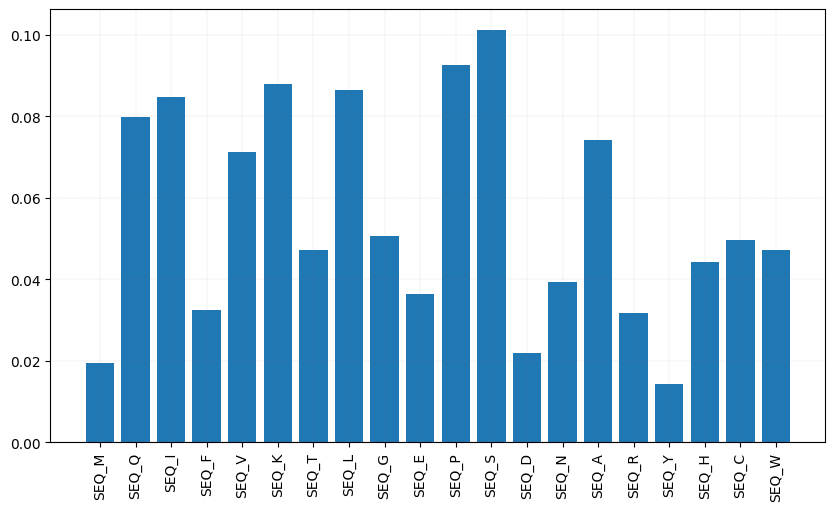

In [57]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var1 (RNN).csv")

## Model sparsity

In [58]:
verbose = 0
SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in search_space.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter]
      
clear_output(wait=True)  

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
2,2.0,20.782,0.315626,94.786,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00002,97.484,32.380,97.090,35.528,97.286,33.808
3,2.0,15.028,0.344670,94.198,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00003,97.392,27.656,96.562,33.410,96.972,30.048
1,2.0,12.626,0.362120,94.252,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00001,97.288,27.062,96.726,30.588,97.002,28.478


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,12.626,0.362120,94.252,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00001,97.288,27.062,96.726,30.588,97.002,28.478
2,2.0,20.782,0.315626,94.786,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00002,97.484,32.380,97.090,35.528,97.286,33.808
3,2.0,15.028,0.344670,94.198,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00003,97.392,27.656,96.562,33.410,96.972,30.048


In [59]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 41, 20)
output sequence shape: (11356, 2)
f1 score: 33.94
f1 score: 34.59
f1 score: 29.19
f1 score: 35.84
f1 score: 35.480000000000004
best f1 score: 33.80800000000001


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,20.782,0.315626,94.786,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00002,97.484,32.38,97.09,35.528,97.286,33.808


SEQ_M    0.004720
SEQ_Q    0.002450
SEQ_I    0.010179
SEQ_F    0.008210
SEQ_V    0.013252
SEQ_K    0.006467
SEQ_T    0.007206
SEQ_L    0.016406
SEQ_G    0.012882
SEQ_E    0.008345
SEQ_P    0.006808
SEQ_S    0.012497
SEQ_D    0.003602
SEQ_N    0.007735
SEQ_A    0.014677
SEQ_R    0.012604
SEQ_Y    0.009218
SEQ_H    0.003862
SEQ_C    0.008498
SEQ_W    0.009840
dtype: float32

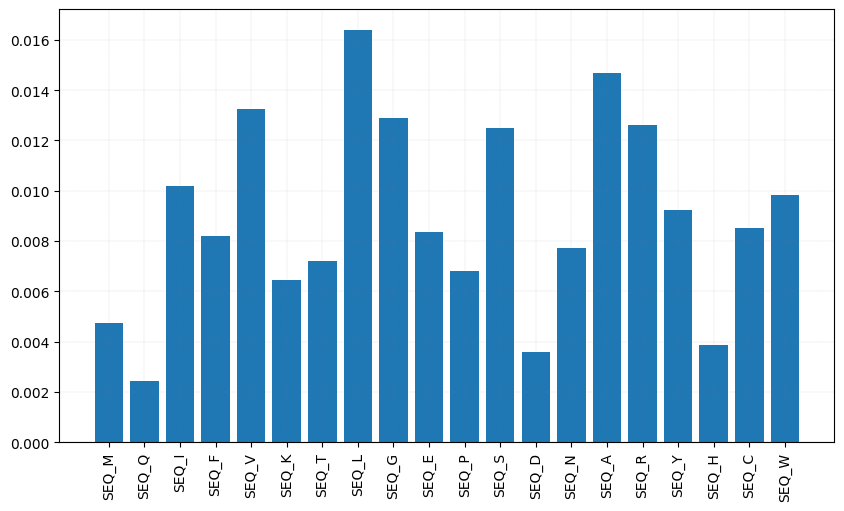

In [60]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var1 (SRNN).csv")

# variable set 2

## set variables

In [61]:
DATASET = RAW_DATA.reset_index(drop=True)

VAR_X_CTS = ['flexibility']
VAR_X_CTS += list(TARGET_AA.columns[24:28]) # Local features
VAR_X_CTS += list(TARGET_AA.columns[6:16]) # Secondary structure
VAR_X_CAT = ['SEQ', 'SS']

VAR_Y_CTS = []
VAR_Y_CAT = ['positivity']

XY_CAT = VAR_X_CAT + VAR_Y_CAT
VAR_X  = VAR_X_CTS + VAR_X_CAT
VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

DUMMIES_DICT = dict(
    zip(XY_CAT, 
        [list(DATASET[var].unique()) for var in XY_CAT])
)

## Find the best architecture

In [62]:
update = False
verbose = 0

parameters = initial_parameters.copy()

SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in SEARCH_SPACE.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = int(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter])
      
clear_output(wait=True)

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,10.218,0.324899,94.700,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.020,35.058,97.242,33.156
10,2.0,10.218,0.324899,94.700,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.020,35.058,97.242,33.156
9,2.0,11.470,0.365520,94.834,0.001,20.0,4.0,64.0,2.0,128.0,1.0,0.0,97.424,32.582,97.200,33.882,97.310,33.084
5,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840
8,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,6.574,0.436825,95.010,0.001,10.0,3.0,128.0,3.0,128.0,1.0,0.0,96.938,27.610,97.906,20.472,97.420,23.478
2,2.0,7.482,0.422626,95.342,0.001,15.0,3.0,128.0,3.0,128.0,1.0,0.0,97.130,33.526,98.062,25.412,97.594,28.868
3,2.0,10.556,0.346874,95.000,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.230,31.666,97.586,28.470,97.406,29.800
4,2.0,10.556,0.346874,95.000,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.230,31.666,97.586,28.470,97.406,29.800
5,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840
6,2.0,13.498,0.310038,94.984,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.332,32.768,97.458,31.292,97.394,31.728
7,2.0,10.218,0.324899,94.700,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.020,35.058,97.242,33.156
8,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840
9,2.0,11.470,0.365520,94.834,0.001,20.0,4.0,64.0,2.0,128.0,1.0,0.0,97.424,32.582,97.200,33.882,97.310,33.084


In [63]:
display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
print('X feature shape:', TRAIN_X.shape)
print('X feature list:', feature_x)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,10.218,0.324899,94.700,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.020,35.058,97.242,33.156
10,2.0,10.218,0.324899,94.700,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.020,35.058,97.242,33.156
9,2.0,11.470,0.365520,94.834,0.001,20.0,4.0,64.0,2.0,128.0,1.0,0.0,97.424,32.582,97.200,33.882,97.310,33.084
5,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840
8,2.0,9.580,0.345805,95.388,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.300,36.488,97.924,30.118,97.612,32.840


X feature shape: (17490, 41, 38)
X feature list: ['flexibility', 'nAli(-3, -1)', 'nPos(-7, -5)', 'nS/nT', 'is_proline(1)', 'ASA', 'Phi', 'Psi', 'Theta(i-1=>i+1)', 'Tau(i-2=>i+2)', 'HSE_alpha_up', 'HSE_alpha_down', 'P(C)', 'P(H)', 'P(E)', 'SEQ_M', 'SEQ_Q', 'SEQ_I', 'SEQ_F', 'SEQ_V', 'SEQ_K', 'SEQ_T', 'SEQ_L', 'SEQ_G', 'SEQ_E', 'SEQ_P', 'SEQ_S', 'SEQ_D', 'SEQ_N', 'SEQ_A', 'SEQ_R', 'SEQ_Y', 'SEQ_H', 'SEQ_C', 'SEQ_W', 'SS_E', 'SS_C', 'SS_H']


In [64]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 41, 38)
output sequence shape: (11356, 2)


f1 score: 29.41
f1 score: 31.02
f1 score: 33.96
f1 score: 37.27
f1 score: 34.12
best f1 score: 33.156


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,10.218,0.324899,94.7,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.0,97.468,31.956,97.02,35.058,97.242,33.156


flexibility        0.028963
nAli(-3, -1)       0.021578
nPos(-7, -5)       0.047648
nS/nT              0.045798
is_proline(1)      0.013921
ASA                0.027664
Phi                0.048100
Psi                0.031974
Theta(i-1=>i+1)    0.024906
Tau(i-2=>i+2)      0.046158
HSE_alpha_up       0.018341
HSE_alpha_down     0.024184
P(C)               0.029486
P(H)               0.031696
P(E)               0.019461
SEQ_M              0.045545
SEQ_Q              0.044721
SEQ_I              0.055561
SEQ_F              0.041642
SEQ_V              0.070979
SEQ_K              0.031841
SEQ_T              0.054913
SEQ_L              0.020523
SEQ_G              0.014091
SEQ_E              0.026762
SEQ_P              0.071120
SEQ_S              0.050717
SEQ_D              0.026397
SEQ_N              0.043668
SEQ_A              0.032352
SEQ_R              0.027962
SEQ_Y              0.020647
SEQ_H              0.038323
SEQ_C              0.055178
SEQ_W              0.088818
SS_E               0

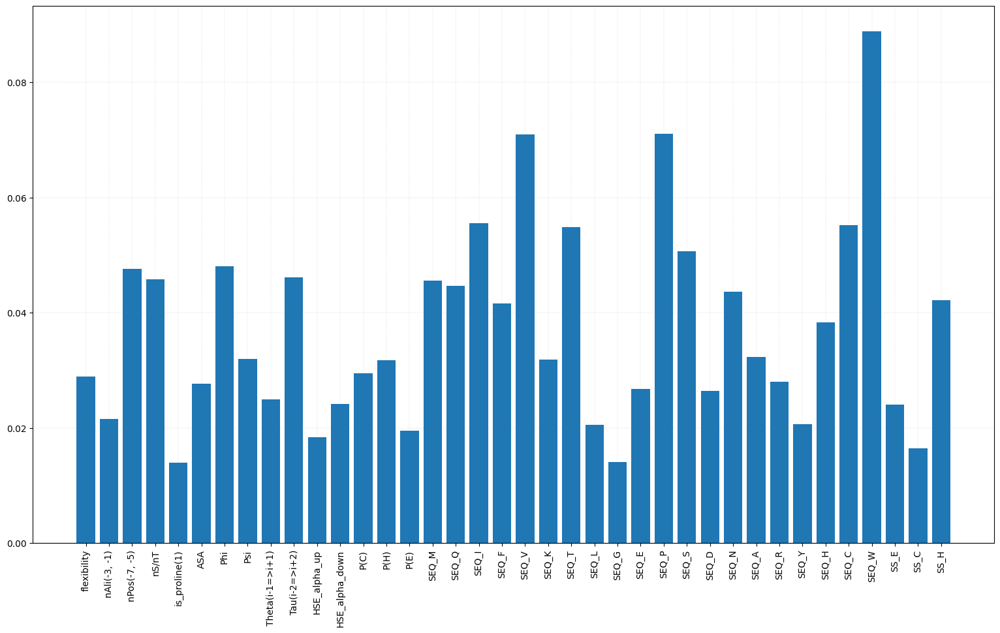

In [65]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var2 (RNN).csv")

## Model sparsity

In [66]:
verbose = 0
SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in search_space.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter]
      
clear_output(wait=True)  

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
2,2.0,12.832,0.354393,94.694,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00002,97.448,31.160,97.028,34.586,97.236,32.738
3,2.0,10.464,0.352359,94.386,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00003,97.464,29.298,96.680,35.294,97.070,31.934
1,2.0,14.056,0.367528,94.426,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00001,97.290,28.040,96.910,30.588,97.098,29.140


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,14.056,0.367528,94.426,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00001,97.290,28.040,96.910,30.588,97.098,29.140
2,2.0,12.832,0.354393,94.694,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00002,97.448,31.160,97.028,34.586,97.236,32.738
3,2.0,10.464,0.352359,94.386,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00003,97.464,29.298,96.680,35.294,97.070,31.934


In [67]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 41, 38)
output sequence shape: (11356, 2)
f1 score: 28.92
f1 score: 29.35
f1 score: 32.09
f1 score: 36.870000000000005
f1 score: 36.46
best f1 score: 32.738


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,12.832,0.354393,94.694,0.001,20.0,4.0,64.0,3.0,128.0,1.0,0.00002,97.448,31.16,97.028,34.586,97.236,32.738


flexibility        0.008749
nAli(-3, -1)       0.007802
nPos(-7, -5)       0.010551
nS/nT              0.004410
is_proline(1)      0.006396
ASA                0.005985
Phi                0.003846
Psi                0.021314
Theta(i-1=>i+1)    0.009813
Tau(i-2=>i+2)      0.018098
HSE_alpha_up       0.005212
HSE_alpha_down     0.010223
P(C)               0.018612
P(H)               0.004439
P(E)               0.004549
SEQ_M              0.007672
SEQ_Q              0.010662
SEQ_I              0.005736
SEQ_F              0.005730
SEQ_V              0.005661
SEQ_K              0.008025
SEQ_T              0.013771
SEQ_L              0.010169
SEQ_G              0.005560
SEQ_E              0.006397
SEQ_P              0.005639
SEQ_S              0.017086
SEQ_D              0.006096
SEQ_N              0.004557
SEQ_A              0.007196
SEQ_R              0.009833
SEQ_Y              0.002561
SEQ_H              0.004781
SEQ_C              0.004859
SEQ_W              0.003530
SS_E               0

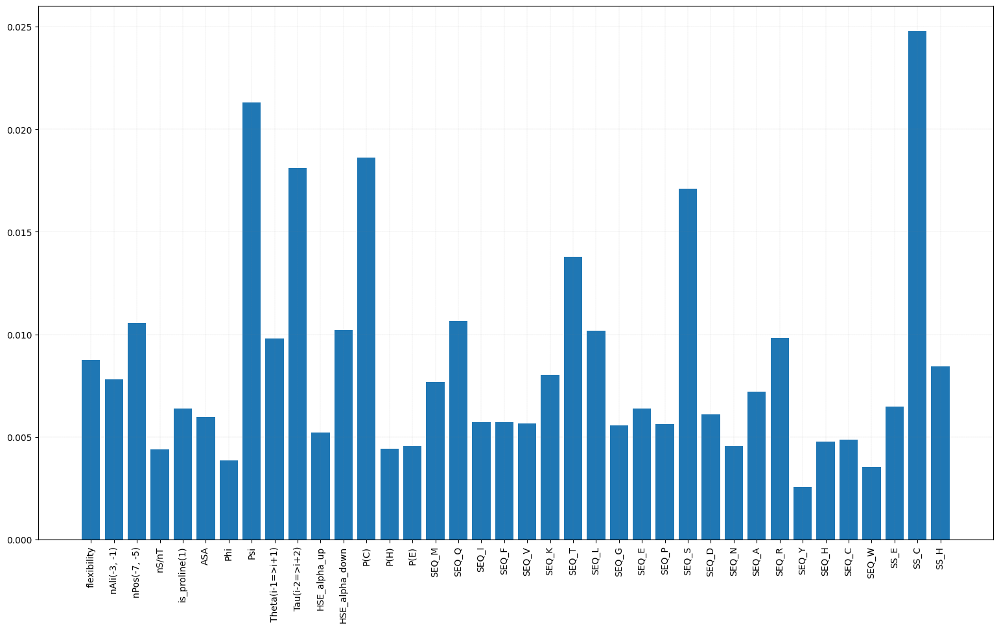

In [68]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var2 (SRNN).csv")

# variable set 3

## set variables

In [69]:
DATASET = RAW_DATA.reset_index(drop=True)

VAR_X_CTS = []
VAR_X_CTS += list(TARGET_AA.columns[29:]) # Structure-based features
VAR_X_CAT = ['SEQ']

VAR_Y_CTS = []
VAR_Y_CAT = ['positivity']

XY_CAT = VAR_X_CAT + VAR_Y_CAT
VAR_X  = VAR_X_CTS + VAR_X_CAT
VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

DUMMIES_DICT = dict(
    zip(XY_CAT, 
        [list(DATASET[var].unique()) for var in XY_CAT])
)

## Find the best architecture

In [70]:
update = False
verbose = 0

parameters = initial_parameters.copy()

SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in SEARCH_SPACE.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = int(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter])
      
clear_output(wait=True)

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,12.784,0.385840,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.700,97.632,33.884,97.534,34.634
10,2.0,12.784,0.385840,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.700,97.632,33.884,97.534,34.634
9,2.0,11.374,0.337733,95.036,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.462,34.460,97.374,34.824,97.418,34.468
6,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784
8,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,6.772,0.431942,95.016,0.001,10.0,3.0,128.0,3.0,128.0,1.0,0.0,97.034,29.380,97.814,23.060,97.424,25.796
2,2.0,8.596,0.410491,95.412,0.001,15.0,3.0,128.0,3.0,128.0,1.0,0.0,97.012,33.136,98.264,22.118,97.634,26.352
3,2.0,9.322,0.405628,95.406,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.252,36.792,97.996,28.708,97.620,31.872
4,2.0,9.322,0.405628,95.406,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.252,36.792,97.996,28.708,97.620,31.872
5,2.0,13.668,0.327268,95.026,0.001,20.0,4.0,128.0,3.0,128.0,1.0,0.0,97.180,31.398,97.668,27.058,97.420,28.408
6,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784
7,2.0,12.784,0.385840,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.700,97.632,33.884,97.534,34.634
8,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784
9,2.0,11.374,0.337733,95.036,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.462,34.460,97.374,34.824,97.418,34.468


In [71]:
display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
print('X feature shape:', TRAIN_X.shape)
print('X feature list:', feature_x)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
7,2.0,12.784,0.385840,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.700,97.632,33.884,97.534,34.634
10,2.0,12.784,0.385840,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.700,97.632,33.884,97.534,34.634
9,2.0,11.374,0.337733,95.036,0.001,20.0,5.0,64.0,2.0,128.0,1.0,0.0,97.462,34.460,97.374,34.824,97.418,34.468
6,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784
8,2.0,11.272,0.325619,95.402,0.001,20.0,5.0,128.0,3.0,128.0,1.0,0.0,97.354,36.794,97.888,31.530,97.620,33.784


X feature shape: (17490, 41, 559)
X feature list: ['number_hydrophobic_0A', 'number_hydrophilic_0A', 'number_polar_0A', 'number_aromatic_0A', 'number_aliphatic_0A', 'number_charged_0A', 'number_positive_0A', 'number_negative_0A', 'number_gly_0A', 'number_very_small_0A', 'number_small_0A', 'number_normal_0A', 'number_long_0A', 'number_pro_0A', 'number_A_polar_uncharged_with_hydroxyl_group_0A', 'number_b_polar_uncharged_with_amide_0A', 'number_d_negatively_charged_polar_0A', 'number_e_non_polar_suffered_0A', 'number_f_non_polar_aromatic_0A', 'number_ala_0A', 'number_cys_0A', 'number_asp_0A', 'number_glu_0A', 'number_phe_0A', 'number_his_0A', 'number_ile_0A', 'number_lys_0A', 'number_leu_0A', 'number_met_0A', 'number_asn_0A', 'number_gln_0A', 'number_arg_0A', 'number_ser_0A', 'number_thr_0A', 'number_val_0A', 'number_trp_0A', 'number_tyr_0A', 'sasa_hydrophobic_0A', 'sasa_hydrophilic_0A', 'sasa_polar_0A', 'sasa_aromatic_0A', 'sasa_aliphatic_0A', 'sasa_charged_0A', 'sasa_positive_0A', 'sasa

In [72]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 41, 559)
output sequence shape: (11356, 2)
f1 score: 28.000000000000004
f1 score: 36.47
f1 score: 36.71
f1 score: 36.36
f1 score: 35.63
best f1 score: 34.634


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,12.784,0.38584,95.248,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.0,97.436,35.7,97.632,33.884,97.534,34.634


number_hydrophobic_0A    0.013334
number_hydrophilic_0A    0.010994
number_polar_0A          0.026379
number_aromatic_0A       0.019673
number_aliphatic_0A      0.008795
                           ...   
SEQ_R                    0.021732
SEQ_Y                    0.017217
SEQ_H                    0.032135
SEQ_C                    0.014983
SEQ_W                    0.026870
Length: 559, dtype: float32

In [73]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var3 (RNN).csv")

In [74]:
parameters_standard = parameters.copy()

## Model sparsity

In [75]:
verbose = 0
SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

search_space_var3 = {
    'learning_rate' : [],
    'window_size' : [],
    'rnn_layers'  : [],
    'rnn_neurons' : [],
    'dnn_layers'  : [],
    'dnn_neurons' : [],
    'weight_loss' : [],
    'c_value'     : [c_value, 2*c_value, 3*c_value, 4*c_value, 5*c_value],
}

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in search_space_var3.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter]
      
clear_output(wait=True)  

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
5,2.0,22.866,0.433161,93.574,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00005,97.592,26.770,95.682,39.294,96.626,31.656
4,2.0,20.804,0.430999,93.468,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00004,97.612,26.096,95.554,39.766,96.568,31.266
3,2.0,25.158,0.418421,94.006,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00003,97.502,27.874,96.242,36.468,96.864,31.042
2,2.0,22.634,0.413484,94.192,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00002,97.444,27.940,96.496,34.824,96.968,30.886
1,2.0,22.580,0.409509,94.278,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00001,97.360,27.906,96.680,32.470,97.018,29.714


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,22.580,0.409509,94.278,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00001,97.360,27.906,96.680,32.470,97.018,29.714
2,2.0,22.634,0.413484,94.192,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00002,97.444,27.940,96.496,34.824,96.968,30.886
3,2.0,25.158,0.418421,94.006,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00003,97.502,27.874,96.242,36.468,96.864,31.042
4,2.0,20.804,0.430999,93.468,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00004,97.612,26.096,95.554,39.766,96.568,31.266
5,2.0,22.866,0.433161,93.574,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00005,97.592,26.770,95.682,39.294,96.626,31.656


In [76]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights_var3 = pd.Series(feature_weights, index=feature_x)
display(feature_weights_var3)

input sequence shape : (11356, 41, 559)
output sequence shape: (11356, 2)
f1 score: 30.54
f1 score: 26.98
f1 score: 34.260000000000005
f1 score: 37.23
f1 score: 29.270000000000003
best f1 score: 31.656


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,22.866,0.433161,93.574,0.001,20.0,5.0,64.0,3.0,128.0,1.0,0.00005,97.592,26.77,95.682,39.294,96.626,31.656


number_hydrophobic_0A    0.004287
number_hydrophilic_0A    0.004043
number_polar_0A          0.002149
number_aromatic_0A       0.000557
number_aliphatic_0A      0.001566
                           ...   
SEQ_R                    0.000410
SEQ_Y                    0.000057
SEQ_H                    0.000246
SEQ_C                    0.000167
SEQ_W                    0.000094
Length: 559, dtype: float32

In [77]:
parameters_sparse = parameters.copy()
parameters_sparse

{'learning_rate': 0.001,
 'window_size': 20,
 'rnn_layers': 5,
 'rnn_neurons': 64,
 'dnn_layers': 3,
 'dnn_neurons': 128,
 'weight_loss': 1,
 'c_value': 5e-05}

In [78]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights_var3)), feature_weights_var3, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights_var3.to_csv(f"./data/Feature weights var3 (SRNN).csv")

# variable set 4: Select important features

## Find the best architecture

In [79]:
ratio_list = [0.3, 0.4, 0.5, 0.6]
    
update = False
verbose = 0

MODELs = []
PERFORMANCE = []
model_id = 1
for ratio in ratio_list:
    selected_features = list(feature_weights_var3[feature_weights_var3 > ratio*feature_weights_var3.max()].index)
    search_terms = ['0A', '5A', '10A', '15A', '20A', '25A']
    VAR_X_AUG = [x for x in selected_features if any(term in x for term in search_terms) and 'resid' not in x]
    
    DATASET = RAW_DATA.reset_index(drop=True)

    VAR_X_CTS = []
    VAR_X_CTS += VAR_X_AUG # selected structure-based features
    VAR_X_CAT = ['SEQ']

    VAR_Y_CTS = []
    VAR_Y_CAT = ['positivity']

    XY_CAT = VAR_X_CAT + VAR_Y_CAT
    VAR_X  = VAR_X_CTS + VAR_X_CAT
    VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

    DUMMIES_DICT = dict(
        zip(XY_CAT, 
            [list(DATASET[var].unique()) for var in XY_CAT])
    )


    parameters = initial_parameters.copy()

    SEED = 0
    keras.utils.set_random_seed(SEED)
    tf.config.experimental.enable_op_determinism()

    for parameter, search_list in SEARCH_SPACE.items():
        if len(search_list) > 1:
            for value in search_list:
                parameters[parameter] = value
                
                SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                            VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
                sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
                
                DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
                splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
                print(f'input sequence shape : {DATA_X.shape}')
                print(f'output sequence shape: {DATA_Y.shape}')
                print(f'''{parameter}: {value} among {search_list}''')
                
                for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                    
                    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                    np.random.seed(SEED)
                    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                    if not exists(model_path) or update:
                        time_start = time.time()
                        LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                            epochs = epochs, callbacks = callbacks, 
                                            validation_split = test_size/(1-test_size), shuffle=False)
                        time_end = time.time()
                        training_time = round((time_end - time_start)/60, 2)
                        
                        test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                        performance = {'cv_idx': cv_idx,
                                    'training_time': training_time,
                                    'test_loss': test_loss,
                                    'accuracy': accuracy,
                                    'ratio'   : ratio,
                                    **LSTM_MODEL.parameters,
                                    **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                    **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                    **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                        }
                        
                        LSTM_MODEL.model.save_weights(model_path)
                        
                        performance = pd.DataFrame([performance])
                        performance.to_csv(result_path, index=False)
                        
                    else:
                        LSTM_MODEL.model.load_weights(model_path)
                        performance = pd.read_csv(result_path, header=0)
                    
                    performance['model_id'] = model_id
                    PERFORMANCE.append(performance)
                    MODELs.append(LSTM_MODEL)
                    
                    print(f'f1 score: {performance.f1_1[0]}')

                clear_output(wait=True)
                PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
                f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
                print(f'best f1 score: {f1_best}')
                display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
                display(PERFORMANCE_MEAN)
                model_id += 1
            
            parameters[parameter] = int(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter])
        
clear_output(wait=True)
print('final parameters:\n', parameters)

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

final parameters:
 {'learning_rate': 0.001, 'window_size': 15, 'rnn_layers': 5, 'rnn_neurons': 128, 'dnn_layers': 3, 'dnn_neurons': 128, 'weight_loss': 1, 'c_value': 0}


,cv_idx,training_time,test_loss,accuracy,ratio,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,,
32,2.0,8.494,0.325291,95.086,0.5,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.458,34.408,97.440,34.588,97.448,34.440
30,2.0,8.494,0.325291,95.086,0.5,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.458,34.408,97.440,34.588,97.448,34.440
28,2.0,8.494,0.325291,95.086,0.5,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.458,34.408,97.440,34.588,97.448,34.440
33,2.0,12.488,0.336232,95.482,0.5,0.001,15.0,5.0,128.0,4.0,128.0,1.0,0.0,97.346,37.782,97.978,31.296,97.660,34.122
21,2.0,7.828,0.354659,95.246,0.4,0.001,15.0,4.0,128.0,3.0,128.0,1.0,0.0,97.386,35.910,97.686,32.472,97.534,33.436


,cv_idx,training_time,test_loss,accuracy,ratio,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,,
1,2.0,6.744,0.363651,95.318,0.3,0.001,10.0,3.0,128.0,3.0,128.0,1.0,0.0,97.042,32.722,98.126,23.058,97.582,27.012
2,2.0,8.724,0.348945,95.458,0.3,0.001,15.0,3.0,128.0,3.0,128.0,1.0,0.0,97.194,36.608,98.116,27.056,97.650,30.268
3,2.0,9.760,0.347649,95.580,0.3,0.001,20.0,3.0,128.0,3.0,128.0,1.0,0.0,97.130,36.608,98.318,25.178,97.718,29.696
4,2.0,8.724,0.348945,95.458,0.3,0.001,15.0,3.0,128.0,3.0,128.0,1.0,0.0,97.194,36.608,98.116,27.056,97.650,30.268
5,2.0,11.128,0.356166,95.360,0.3,0.001,15.0,4.0,128.0,3.0,128.0,1.0,0.0,97.234,35.226,97.968,28.234,97.598,30.838
6,2.0,12.436,0.338125,95.114,0.3,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.312,33.808,97.622,30.588,97.464,31.514
7,2.0,10.308,0.349261,95.088,0.3,0.001,15.0,5.0,64.0,3.0,128.0,1.0,0.0,97.320,32.790,97.586,30.822,97.450,31.502
8,2.0,12.436,0.338125,95.114,0.3,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.312,33.808,97.622,30.588,97.464,31.514
9,2.0,11.754,0.317280,95.406,0.3,0.001,15.0,5.0,128.0,2.0,128.0,1.0,0.0,97.218,35.586,98.034,27.764,97.622,30.818


In [80]:
verbose = 0
SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

ratio = 0.5
selected_features = list(feature_weights_var3[feature_weights_var3 > ratio*feature_weights_var3.max()].index)
search_terms = ['0A', '5A', '10A', '15A', '20A', '25A']
VAR_X_AUG = [x for x in selected_features if any(term in x for term in search_terms) and 'resid' not in x]

DATASET = RAW_DATA.reset_index(drop=True)

VAR_X_CTS = []
VAR_X_CTS += VAR_X_AUG # selected structure-based features
VAR_X_CAT = ['SEQ']

VAR_Y_CTS = []
VAR_Y_CAT = ['positivity']

XY_CAT = VAR_X_CAT + VAR_Y_CAT
VAR_X  = VAR_X_CTS + VAR_X_CAT
VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

DUMMIES_DICT = dict(
    zip(XY_CAT, 
        [list(DATASET[var].unique()) for var in XY_CAT])
)

SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 31, 35)
output sequence shape: (11356, 2)
f1 score: 28.74
f1 score: 35.5
f1 score: 33.129999999999995
f1 score: 37.87
f1 score: 36.96
best f1 score: 34.44


,cv_idx,training_time,test_loss,accuracy,ratio,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,,
45,2.0,8.494,0.325291,95.086,0.5,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.0,97.458,34.408,97.44,34.588,97.448,34.44


number_hydrophobic_0A      0.050210
number_hydrophilic_0A      0.061030
number_polar_0A            0.066342
number_charged_0A          0.040838
number_gly_0A              0.036216
number_very_small_0A       0.034648
number_normal_0A           0.037313
number_pro_0A              0.071911
sasa_cys_5A                0.040397
sasa_gly_15A               0.042018
sasa_met_20A               0.055975
net_charge_backbone_20A    0.071427
number_gln_25A             0.052922
sasa_trp_25A               0.046095
net_charge_backbone_25A    0.063961
SEQ_M                      0.031780
SEQ_Q                      0.053687
SEQ_I                      0.060692
SEQ_F                      0.006681
SEQ_V                      0.029918
SEQ_K                      0.047271
SEQ_T                      0.064921
SEQ_L                      0.046744
SEQ_G                      0.036377
SEQ_E                      0.040380
SEQ_P                      0.070557
SEQ_S                      0.071745
SEQ_D                      0

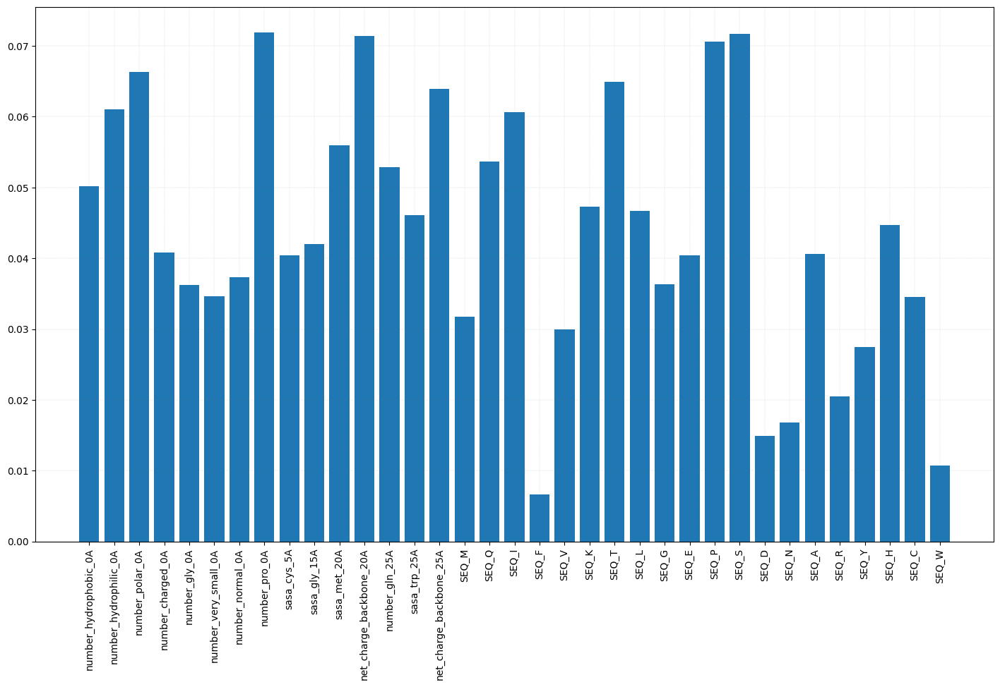

In [81]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var4 (RNN).csv")

## Model sparsity

In [82]:
verbose = 0
SEED = 0
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

ratio = 0.5
selected_features = list(feature_weights_var3[feature_weights_var3 > ratio*feature_weights_var3.max()].index)
search_terms = ['0A', '5A', '10A', '15A', '20A', '25A']
VAR_X_AUG = [x for x in selected_features if any(term in x for term in search_terms) and 'resid' not in x]

DATASET = RAW_DATA.reset_index(drop=True)

VAR_X_CTS = []
VAR_X_CTS += VAR_X_AUG # selected structure-based features
VAR_X_CAT = ['SEQ']

VAR_Y_CTS = []
VAR_Y_CAT = ['positivity']

XY_CAT = VAR_X_CAT + VAR_Y_CAT
VAR_X  = VAR_X_CTS + VAR_X_CAT
VAR_Y  = VAR_Y_CTS + VAR_Y_CAT

DUMMIES_DICT = dict(
    zip(XY_CAT, 
        [list(DATASET[var].unique()) for var in XY_CAT])
)

last_space = {
    'learning_rate' : [],
    'window_size' : [],
    'rnn_layers'  : [],
    'rnn_neurons' : [],
    'dnn_layers'  : [],
    'dnn_neurons' : [],
    'weight_loss' : [],
    'c_value'     : [0.1*c_value, 0.2*c_value, 0.3*c_value, 0.4*c_value, 0.5*c_value, 0.6*c_value],
}

MODELs = []
PERFORMANCE = []
model_id = 1
for parameter, search_list in last_space.items():
    if len(search_list) > 1:
        for value in search_list:
            parameters[parameter] = value
            
            SEQUENCE_X, SEQUENCE_Y, feature_x, _ = preprocess_data(protein_list, DATA_PATH, parameters['window_size'],
                                                           VAR_X_CTS, VAR_X_CAT, VAR_Y_CTS, VAR_Y_CAT, DUMMIES_DICT)
            sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)
            
            DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
            splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
            print(f'input sequence shape : {DATA_X.shape}')
            print(f'output sequence shape: {DATA_Y.shape}')
            print(f'''{parameter}: {value} among {search_list}''')
            
            for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
                LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
                
                TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
                TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
                np.random.seed(SEED)
                TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

                model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
                result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'

                if not exists(model_path) or update:
                    time_start = time.time()
                    LSTM_MODEL.model.fit(TRAIN_X, TRAIN_Y, verbose=verbose, 
                                        epochs = epochs, callbacks = callbacks, 
                                        validation_split = test_size/(1-test_size), shuffle=False)
                    time_end = time.time()
                    training_time = round((time_end - time_start)/60, 2)
                    
                    test_loss, accuracy, precision, recall, f1 = evaluate_cls(LSTM_MODEL.model, TEST_X, TEST_Y)

                    performance = {'cv_idx': cv_idx,
                                'training_time': training_time,
                                'test_loss': test_loss,
                                'accuracy': accuracy,
                                **LSTM_MODEL.parameters,
                                **{f'precision_{x}': precision[x] for x in range(len(precision))},
                                **{f'recall_{x}'   : recall[x] for x in range(len(recall))},
                                **{f'f1_{x}'       : f1[x] for x in range(len(f1))}
                    }
                    
                    LSTM_MODEL.model.save_weights(model_path)
                    
                    performance = pd.DataFrame([performance])
                    performance.to_csv(result_path, index=False)
                    
                else:
                    LSTM_MODEL.model.load_weights(model_path)
                    performance = pd.read_csv(result_path, header=0)
                
                performance['model_id'] = model_id
                PERFORMANCE.append(performance)
                MODELs.append(LSTM_MODEL)
                
                print(f'f1 score: {performance.f1_1[0]}')

            clear_output(wait=True)
            PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
            f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
            print(f'best f1 score: {f1_best}')
            display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
            display(PERFORMANCE_MEAN)
            model_id += 1
        
        parameters[parameter] = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0][parameter]
      
clear_output(wait=True)  

display(PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[:5])
display(PERFORMANCE_MEAN)

,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
3,2.0,15.584,0.354570,95.228,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000003,97.374,35.338,97.678,32.236,97.526,33.518
4,2.0,14.464,0.328283,95.370,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000004,97.334,36.386,97.870,31.058,97.602,33.318
2,2.0,9.890,0.320081,94.860,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000002,97.402,32.170,97.256,33.178,97.324,32.480
5,2.0,12.260,0.322036,95.122,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000005,97.296,34.230,97.650,30.120,97.472,31.698
1,2.0,14.596,0.362213,95.070,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000001,97.266,33.488,97.622,29.410,97.442,31.096


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,14.596,0.362213,95.070,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000001,97.266,33.488,97.622,29.410,97.442,31.096
2,2.0,9.890,0.320081,94.860,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000002,97.402,32.170,97.256,33.178,97.324,32.480
3,2.0,15.584,0.354570,95.228,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000003,97.374,35.338,97.678,32.236,97.526,33.518
4,2.0,14.464,0.328283,95.370,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000004,97.334,36.386,97.870,31.058,97.602,33.318
5,2.0,12.260,0.322036,95.122,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000005,97.296,34.230,97.650,30.120,97.472,31.698
6,2.0,17.420,0.351607,95.194,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000006,97.244,33.498,97.778,28.708,97.510,30.852


In [83]:
SEED = 0
model_id = 1
keras.utils.set_random_seed(SEED)
tf.config.experimental.enable_op_determinism()

sample_indices = np.random.choice(range(len(SEQUENCE_X)), size=int(len(SEQUENCE_X) * sample_ratio), replace=False)

DATA_X, DATA_Y = SEQUENCE_X[sample_indices], SEQUENCE_Y[sample_indices]
splitter = StratifiedShuffleSplit(n_splits=n_splits, test_size=test_size, random_state=SEED)
print(f'input sequence shape : {DATA_X.shape}')
print(f'output sequence shape: {DATA_Y.shape}')

MODELs = []
PERFORMANCE = []
for cv_idx, (train_idx, test_idx) in enumerate(splitter.split(DATA_X, DATA_Y)):
    LSTM_MODEL = LSTM_CLS(parameters, DATA_X.shape, DATA_Y.shape, seed=SEED)
    
    TRAIN_X, TEST_X = data_scaling(DATA_X[train_idx], DATA_X[test_idx])
    TRAIN_Y, TEST_Y = DATA_Y[train_idx], DATA_Y[test_idx]
    np.random.seed(SEED)
    TRAIN_X, TRAIN_Y = upsample_data(TRAIN_X, TRAIN_Y)

    model_path = f'./trained_model/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.h5'
    result_path = f'./cv_result/{LSTM_MODEL.model_id}_CV_{n_splits}_{cv_idx}.csv'
        
    LSTM_MODEL.model.load_weights(model_path)
    performance = pd.read_csv(result_path, header=0)
    
    performance['model_id'] = model_id
    PERFORMANCE.append(performance)
    MODELs.append(LSTM_MODEL)
    
    print(f'f1 score: {performance.f1_1[0]}')

PERFORMANCE_MEAN = pd.concat(PERFORMANCE).groupby('model_id').mean()
f1_best = PERFORMANCE_MEAN.sort_values('f1_1', ascending=False).iloc[0].f1_1
print(f'best f1 score: {f1_best}')
display(PERFORMANCE_MEAN)

for n in range(n_splits):
    weights = MODELs[n].model.get_weights()
    feature_weight = np.abs(weights[0].mean(1)).reshape(1,-1)
    
    if not n:
        feature_weights = feature_weight
        
    else:
        feature_weights = np.concatenate([feature_weights, feature_weight], axis=0)
        
feature_weights = feature_weights.mean(0)
feature_weights = pd.Series(feature_weights, index=feature_x)
display(feature_weights)

input sequence shape : (11356, 31, 35)
output sequence shape: (11356, 2)
f1 score: 25.45
f1 score: 30.14
f1 score: 34.78
f1 score: 36.48
f1 score: 40.74
best f1 score: 33.518


,cv_idx,training_time,test_loss,accuracy,learning_rate,window_size,rnn_layers,rnn_neurons,dnn_layers,dnn_neurons,weight_loss,c_value,precision_0,precision_1,recall_0,recall_1,f1_0,f1_1
model_id,,,,,,,,,,,,,,,,,,
1,2.0,15.584,0.35457,95.228,0.001,15.0,5.0,128.0,3.0,128.0,1.0,0.000003,97.374,35.338,97.678,32.236,97.526,33.518


number_hydrophobic_0A      0.058078
number_hydrophilic_0A      0.054150
number_polar_0A            0.044808
number_charged_0A          0.022096
number_gly_0A              0.011484
number_very_small_0A       0.029406
number_normal_0A           0.013598
number_pro_0A              0.024950
sasa_cys_5A                0.005726
sasa_gly_15A               0.016970
sasa_met_20A               0.005969
net_charge_backbone_20A    0.084605
number_gln_25A             0.026358
sasa_trp_25A               0.009263
net_charge_backbone_25A    0.078395
SEQ_M                      0.005517
SEQ_Q                      0.009620
SEQ_I                      0.012962
SEQ_F                      0.006801
SEQ_V                      0.011016
SEQ_K                      0.004568
SEQ_T                      0.023388
SEQ_L                      0.027485
SEQ_G                      0.011817
SEQ_E                      0.014094
SEQ_P                      0.025619
SEQ_S                      0.040480
SEQ_D                      0

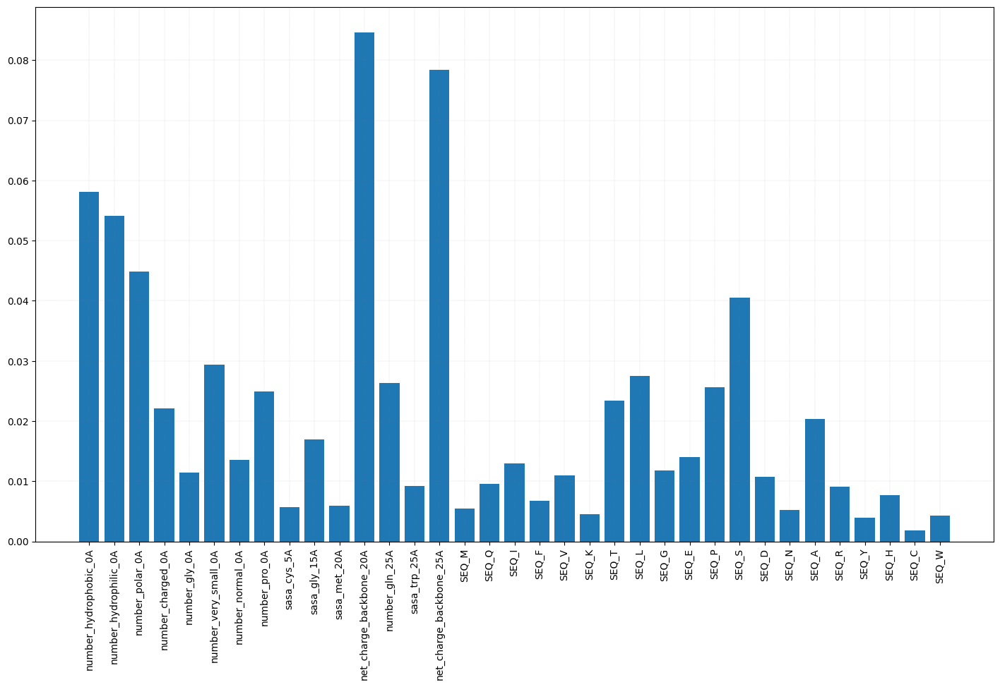

In [84]:
plt.figure(figsize=(len(feature_x)/2, len(feature_x)/2*9/16))
plt.grid(axis='both', color = "grey", linewidth = "0.1", linestyle = "--", zorder=0)
plt.bar(range(len(feature_weights)), feature_weights, align='center')

plt.xticks(ticks=range(len(feature_x)), labels=feature_x, rotation='vertical')

plt.show()
feature_weights.to_csv(f"./data/Feature weights var4 (SRNN).csv")